### Mounting of drive

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


### Linking path to notebook for importing of packages

In [2]:
import sys
drive_path = '/content/gdrive/MyDrive/DeepMirror'
sys.path.insert(0, drive_path)


In [3]:
!pip install pyyaml==5.1


In [ ]:
import torch
#TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
#CUDA_VERSION = torch.__version__.split("+")[-1]

### Installing Detectron2

In [4]:
#!pip install -U torch torchvision
#!pip install git+https://github.com/facebookresearch/fvcore.git
!pip install -e '/content/gdrive/MyDrive/DeepMirror/detectron2'

Obtaining file:///content/gdrive/MyDrive/DeepMirror/detectron2
     |████████████████████████████████| 49 kB 4.7 MB/s 
     |████████████████████████████████| 74 kB 3.3 MB/s 
     |████████████████████████████████| 145 kB 49.8 MB/s 
     |████████████████████████████████| 130 kB 46.9 MB/s 
     |████████████████████████████████| 749 kB 47.9 MB/s 
     |████████████████████████████████| 743 kB 40.6 MB/s 
     |████████████████████████████████| 112 kB 47.8 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20211023-py3-none-any.whl size=60947 sha256=fc41711796731f58a6aa44a4e337c577f27cf77a8e7a545daef1ff03cca6a6c4
  Stored in directory: /root/.cache/pip/wheels/16/98/fc/252d62cab6263c719120e06b28f3378af59b52ce7a20e81852
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=a8bc830b50923ba1098995fb58802dcac14f23a4fa618b0cfe630f29c8ab81f1
  Stored in directory: /root/.cache/pip/wheels/ca/33/b7/336836125fc9bb4ceaa4376d8abc

### Importing some necessary packages required to for smooth running

In [3]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

### Registering the subset of the COCO dataset downloaded to enable access to detectron2 

In [4]:
from detectron2.data.datasets import register_coco_instances

for d in ["train", "val"]:
    register_coco_instances(f"Instance_{d}", {}, f"/content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/annotations/{d}.json", f"/content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/bus_{d}")

In [5]:
import random
from detectron2.utils.visualizer import Visualizer

### Verifying dataloading

WARNING [11/10 07:56:22 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/10 07:56:22 d2.data.datasets.coco]: Loaded 3952 images in COCO format from /content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/annotations/train.json
{'file_name': '/content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/bus_train/000000216921.jpg', 'height': 443, 'width': 640, 'image_id': 3572, 'annotations': [{'iscrowd': 0, 'bbox': [94.0, 131.75, 401.0, 211.0], 'category_id': 0, 'segmentation': [[94.0, 282.75, 118.0, 290.75, 125.0, 305.75, 140.0, 317.75, 153.0, 307.75, 154.0, 300.75, 270.0, 321.75, 290.0, 342.75, 310.0, 342.75, 314.0, 331.75, 380.0, 333.75, 488.0, 330.75, 495.0, 231.75, 489.0, 166.75, 484.0, 155.75, 464.0, 138.75, 393.0, 131.75, 105.0, 168.75, 98.0, 211.75]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}]}


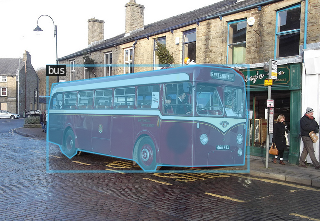

{'file_name': '/content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/bus_train/000000351091.jpg', 'height': 425, 'width': 640, 'image_id': 3784, 'annotations': [{'iscrowd': 0, 'bbox': [154.72, 68.05, 392.53, 297.98], 'category_id': 0, 'segmentation': [[155.67, 159.73, 154.72, 322.09, 174.78, 326.87, 181.46, 332.6, 189.1, 338.33, 193.88, 337.37, 195.79, 333.55, 203.43, 349.79, 215.84, 336.42, 278.88, 348.83, 285.56, 363.16, 294.16, 360.29, 303.71, 357.43, 356.24, 360.29, 425.96, 360.29, 443.15, 366.03, 449.83, 361.25, 506.18, 347.88, 504.27, 190.29, 519.55, 188.38, 529.1, 189.34, 530.06, 205.58, 528.15, 207.49, 530.06, 220.86, 543.43, 229.45, 547.25, 209.4, 544.38, 198.89, 543.43, 183.61, 543.43, 183.61, 529.1, 180.74, 529.1, 180.74, 518.6, 180.74, 518.6, 180.74, 504.27, 182.65, 488.99, 85.24, 488.99, 85.24, 485.17, 82.37, 485.17, 82.37, 372.47, 69.0, 331.4, 68.05, 323.76, 83.33, 327.58, 108.16, 316.12, 116.76, 255.96, 131.08, 257.87, 140.63, 252.13, 145.41, 233.99, 146.36, 222.53,

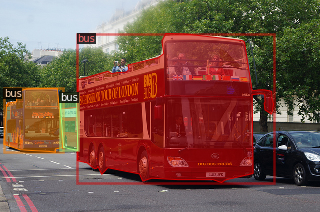

{'file_name': '/content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/bus_train/000000235481.jpg', 'height': 480, 'width': 640, 'image_id': 3709, 'annotations': [{'iscrowd': 0, 'bbox': [172.58, 79.82, 296.63, 322.52], 'category_id': 0, 'segmentation': [[174.74, 228.67, 181.21, 154.25, 192.0, 112.18, 208.18, 96.0, 242.7, 85.21, 293.39, 79.82, 331.15, 79.82, 354.88, 85.21, 395.87, 127.28, 454.11, 179.06, 454.11, 186.61, 458.43, 214.65, 459.51, 244.85, 460.58, 258.88, 469.21, 261.03, 468.13, 273.98, 460.58, 273.98, 460.58, 305.26, 460.58, 313.89, 462.74, 334.38, 460.58, 352.72, 453.03, 359.19, 449.8, 358.11, 404.49, 379.69, 399.1, 394.79, 396.94, 402.34, 389.39, 402.34, 384.0, 391.55, 380.76, 384.0, 355.96, 400.18, 200.63, 389.39, 202.79, 350.56, 199.55, 346.25, 200.63, 262.11, 203.87, 258.88, 207.1, 238.38, 172.58, 228.67]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': 0, 'bbox': [592.75, 268.56, 40.81, 44.03], 'category_id': 0, 'segmentation': [[593.83, 307.22, 592.75, 277.15, 5

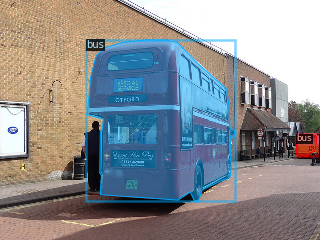

In [6]:
Instance = DatasetCatalog.get("Instance_train")
Instance_metadata = MetadataCatalog.get("Instance_train")
#print(Instance)

for d in random.sample(Instance, 3):
        img = cv2.imread(d["file_name"])
        print(d)
        visualizer = Visualizer(img[:, :, ::-1], metadata=Instance_metadata, scale=0.5)
        vis = visualizer.draw_dataset_dict(d)
        cv2_imshow(vis.get_image()[:, :, ::-1])

### Training the model without noise

In [8]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("Instance_train",)
cfg.DATASETS.TEST = () # no metrics implemented for this dataset 
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = ( 300 ) # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = ( 128 ) # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3 # 3 classes (data, fig, hazelnut)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[11/10 07:35:11 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:15, 11.2MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to

[11/10 07:35:35 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[11/10 07:36:01 d2.utils.events]:  eta: 0:05:49  iter: 19  total_loss: 1.673  loss_cls: 0.5624  loss_box_reg: 0.4724  loss_mask: 0.4841  loss_rpn_cls: 0.02768  loss_rpn_loc: 0.006212  time: 1.2409  data_time: 0.0409  lr: 0.0012854  max_mem: 2760M
[11/10 07:36:27 d2.utils.events]:  eta: 0:05:28  iter: 39  total_loss: 0.6068  loss_cls: 0.07749  loss_box_reg: 0.2681  loss_mask: 0.1627  loss_rpn_cls: 0.01318  loss_rpn_loc: 0.004392  time: 1.2623  data_time: 0.0073  lr: 0.0026174  max_mem: 2760M
[11/10 07:36:53 d2.utils.events]:  eta: 0:05:08  iter: 59  total_loss: 0.5784  loss_cls: 0.138  loss_box_reg: 0.2126  loss_mask: 0.1646  loss_rpn_cls: 0.01241  loss_rpn_loc: 0.01297  time: 1.2687  data_time: 0.0071  lr: 0.0039494  max_mem: 2760M
[11/10 07:37:17 d2.utils.events]:  eta: 0:04:41  iter: 79  total_loss: 0.5971  loss_cls: 0.1177  loss_box_reg: 0.178  loss_mask: 0.2481  loss_rpn_cls: 0.0243  loss_rpn_loc: 0.007848  time: 1.2577  data_time: 0.0073  lr: 0.0052814  max_mem: 2760M
[11/10 07:37

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

### Creating a predictor using the recently trained model to perform inference and evaluation

In [10]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # set the testing threshold for this model
cfg.DATASETS.TEST = ("Instance_val", )
predictor = DefaultPredictor(cfg)

WARNING [11/10 07:44:19 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/10 07:44:19 d2.data.datasets.coco]: Loaded 189 images in COCO format from /content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/annotations/val.json


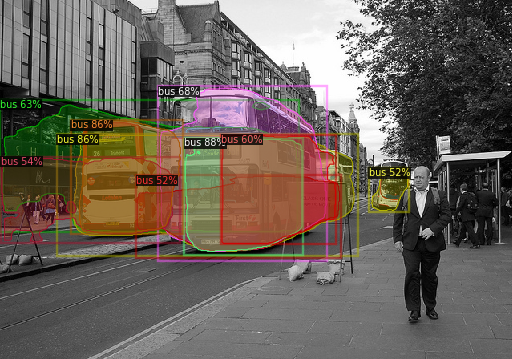

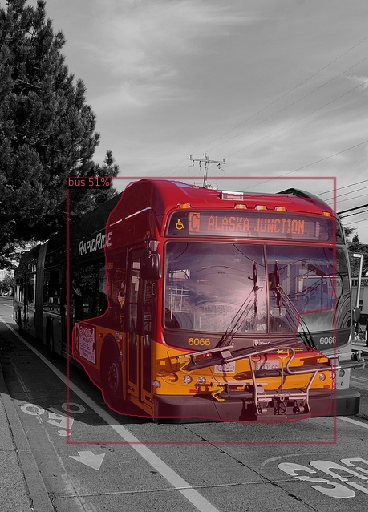

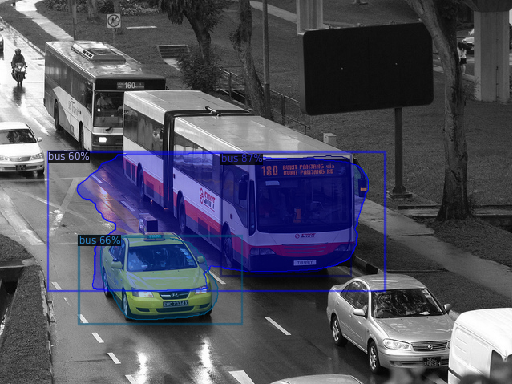

In [11]:
from detectron2.utils.visualizer import ColorMode
InstanceVal = DatasetCatalog.get("Instance_val")
InstanceVal_metadata = MetadataCatalog.get("Instance_val")
for d in random.sample(InstanceVal, 3):  
       im = cv2.imread(d["file_name"])
       outputs = predictor(im)
       v = Visualizer(im[:, :, ::-1], metadata=InstanceVal_metadata ,  scale=0.8,  instance_mode=ColorMode.IMAGE_BW) # remove the colors of unsegmented pixels  )
       v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
       cv2_imshow(v.get_image()[:, :, ::-1])

### Evaluating performance using AP metric

In [13]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("Instance_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "Instance_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [11/10 07:48:22 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/10 07:48:22 d2.data.datasets.coco]: Loaded 189 images in COCO format from /content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/annotations/val.json
[11/10 07:48:22 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    bus     | 283          |
|            |              |
[11/10 07:48:22 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/10 07:48:22 d2.data.common]: Serializing 189 elements to byte tensors and concatenating them all ...
[11/10 07:48:22 d2.data.common]: Serialized dataset takes 0.19 MiB
[11/10 07:48:22 d2.evaluation.evaluator]: Start inference on 189 batches
[11/10 07:48:27 d2.evaluation.evaluator]: Inference done 11/189. Dataloading: 

## Adding feature noise to the latent space of the backbone encoder network

#### Training with feature noise

In [8]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.DATASETS.TEST = ("your-validation-set",) 
cfg.TEST.EVAL_PERIOD = 100
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("Instance_train",)
cfg.DATASETS.TEST = () # no metrics implemented for this dataset cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = ( 300 ) # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = ( 128 ) # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3 # 3 classes (data, fig, hazelnut)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[11/10 07:57:51 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in th

[11/10 07:57:55 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


 
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
 
 
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
 
 
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by multiplying elements of the latent tensor by 1.1
Training with feature noise by

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 670), started 0:23:04 ago. (Use '!kill 670' to kill it.)

<IPython.core.display.Javascript object>

### Creating a predictor using the recently trained (with noise) model to perform inference and evaluation

In [10]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # set the testing threshold for this model
cfg.DATASETS.TEST = ("Instance_val", )
predictor = DefaultPredictor(cfg)

WARNING [11/10 08:11:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/10 08:11:45 d2.data.datasets.coco]: Loaded 189 images in COCO format from /content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/annotations/val.json


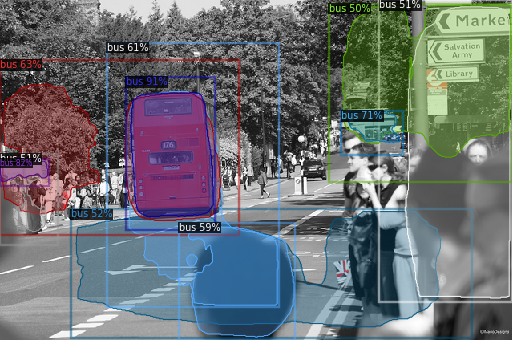

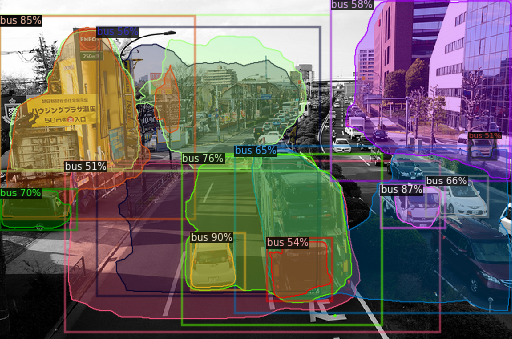

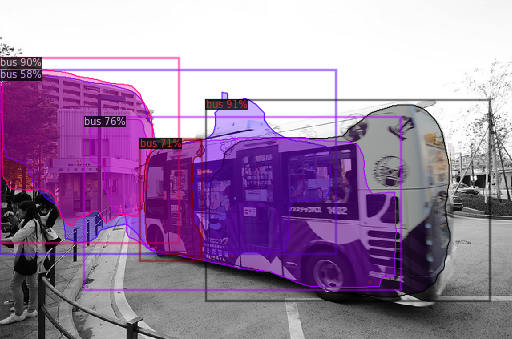

In [11]:
from detectron2.utils.visualizer import ColorMode
fruits_nuts = DatasetCatalog.get("Instance_val")
fruits_nuts_metadata = MetadataCatalog.get("Instance_val")
for d in random.sample(fruits_nuts, 3):  
       im = cv2.imread(d["file_name"])
       outputs = predictor(im)
       v = Visualizer(im[:, :, ::-1], metadata=fruits_nuts_metadata,  scale=0.8,  instance_mode=ColorMode.IMAGE_BW) # remove the colors of unsegmented pixels  )
       v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
       cv2_imshow(v.get_image()[:, :, ::-1])

Obtaining evaluation metric using AP metric

In [12]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("Instance_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "Instance_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [11/10 08:12:06 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/10 08:12:06 d2.data.datasets.coco]: Loaded 189 images in COCO format from /content/gdrive/MyDrive/DeepMirror/COCOdata/subset_dataset/annotations/val.json
[11/10 08:12:06 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    bus     | 283          |
|            |              |
[11/10 08:12:06 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/10 08:12:06 d2.data.common]: Serializing 189 elements to byte tensors and concatenating them all ...
[11/10 08:12:06 d2.data.common]: Serialized dataset takes 0.19 MiB
[11/10 08:12:06 d2.evaluation.evaluator]: Start inference on 189 batches


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[11/10 08:12:10 d2.evaluation.evaluator]: Inference done 11/189. Dataloading: 0.0011 s/iter. Inference: 0.3420 s/iter. Eval: 0.0072 s/iter. Total: 0.3504 s/iter. ETA=0:01:02
[11/10 08:12:16 d2.evaluation.evaluator]: Inference done 26/189. Dataloading: 0.0020 s/iter. Inference: 0.3406 s/iter. Eval: 0.0080 s/iter. Total: 0.3508 s/iter. ETA=0:00:57
[11/10 08:12:21 d2.evaluation.evaluator]: Inference done 40/189. Dataloading: 0.0020 s/iter. Inference: 0.3484 s/iter. Eval: 0.0077 s/iter. Total: 0.3583 s/iter. ETA=0:00:53
[11/10 08:12:26 d2.evaluation.evaluator]: Inference done 54/189. Dataloading: 0.0023 s/iter. Inference: 0.3505 s/iter. Eval: 0.0078 s/iter. Total: 0.3609 s/iter. ETA=0:00:48
[11/10 08:12:31 d2.evaluation.evaluator]: Inference done 69/189. Dataloading: 0.0023 s/iter. Inference: 0.3489 s/iter. Eval: 0.0076 s/iter. Total: 0.3591 s/iter. ETA=0:00:43
[11/10 08:12:37 d2.evaluation.evaluator]: Inference done 84/189. Dataloading: 0.0023 s/iter. Inference: 0.3479 s/iter. Eval: 0.007